<a href="https://colab.research.google.com/github/tpcorreia/Master_AI_2023_UAX/blob/EDA-Training/EDA_Tema_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EDA (Exploratory Data Analysis)
## Cuarta Sesión

Uniendo todas las piezas del puzle. Usando herramienas especializadas

### La Importancia Crucial del EDA en Machine Learning

- **Identificación de Patrones y Anomalías:**
    - El EDA revela patrones esenciales, tendencias y relaciones en los datos, lo cual es crucial para modelar con precisión.
    - Detectar y manejar anomalías y valores atípicos para mejorar la calidad del modelo.
- **Limpieza y Transformación de Datos:**
    - EDA es el proceso mediante el cual se limpian y transforman los datos, asegurando que el modelo de ML reciba datos precisos y relevantes.
    - Incluye imputación de valores faltantes, codificación de variables categóricas y normalización.
- **Selección de Características:**
    - Identificar las variables más relevantes para el modelo, reduciendo la complejidad y mejorando la eficiencia.
- **Reducción de Dimensionalidad:**
    - Utilizar técnicas como PCA para reducir la dimensionalidad, focalizando en los componentes más informativos de los datos.
- **Impacto en el Rendimiento del Modelo:**
    - Un EDA exhaustivo puede llevar a una mejora significativa en la precisión y la eficiencia de los modelos de Machine Learning.

-------
El EDA no es solo un paso preliminar, sino una fase integral en el proceso de modelado de Machine Learning, esencial para maximizar la precisión y la relevancia de los resultados del modelo.


## Preparando el entorno

In [ ]:
import numpy as np
import pandas as pd
import sqlite3
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr, kendalltau

## Descargando los datos
Descargamos la bbdd de github y preparamos el entorno de python

In [ ]:
# download the data to your colab copy
!wget https://github.com/jmpicaza/UAX_AI_master_2023/raw/main/data/house_prices_kaggle.db -O sample_data/house_prices_kaggle.db


--2024-01-22 17:45:57--  https://github.com/jmpicaza/UAX_AI_master_2023/raw/main/data/house_prices_kaggle.db
Resolving github.com (github.com)... 140.82.113.4
Connecting to github.com (github.com)|140.82.113.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/jmpicaza/UAX_AI_master_2023/main/data/house_prices_kaggle.db [following]
--2024-01-22 17:45:58--  https://raw.githubusercontent.com/jmpicaza/UAX_AI_master_2023/main/data/house_prices_kaggle.db
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 815104 (796K) [application/octet-stream]
Saving to: ‘sample_data/house_prices_kaggle.db’

sample_data/house_p 100%[===================>] 796.00K  --.-KB/s    in 0.05s   

2024-01-22 17:45:58 (14.5 MB/s) -

In [ ]:
!pip install jupysql

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.3/93.3 kB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 414.3/414.3 kB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.7/40.7 kB 5.6 MB/s eta 0:00:00


In [ ]:
# make a connection to sqlite db and use sql magic to focus in SQL
conn = sqlite3.connect('sample_data/house_prices_kaggle.db')
%load_ext sql
%sql conn
%config SqlMagic.autopandas = True

# pandas configs
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# data_table.enable_dataframe_formatter()
# data_table.disable_dataframe_formatter()

Deploy AI and data apps for free on Ploomber Cloud! Learn more: https://docs.cloud.ploomber.io/en/latest/quickstart/signup.html


## Carga de datos
Tabla de datos de casas de sklearn

In [ ]:
from sklearn.datasets import fetch_california_housing
df = fetch_california_housing(as_frame=True)
housing_data = df.frame

housing_data.rename(columns={'MedHouseVal': 'target'}, inplace=True)
housing_data['prediction'] = housing_data['target'].values + np.random.normal(0, 5, housing_data.shape[0])

reference = housing_data.sample(n=5000, replace=False)
current = housing_data.sample(n=5000, replace=False)

# leo las query con pandas
df1 = pd.read_sql_query("select * from train", conn)
#df1=df1[:,~np.all(np.isnan(), axis=0)]
#df1.rename(columns={'SalePrice': 'target'}, inplace=True)
df2 = pd.read_sql_query("select * from test", conn)
#df2=df2[:,~np.all(np.isnan(), axis=0)]
#df2.rename(columns={'SalePrice': 'prediction'}, inplace=True)

## Exploración avanzada de datos con librerías especialzadas


### Evidently https://docs.evidentlyai.com/

In [ ]:
try:
    import evidently
except:
    !pip uninstall tensorflow-probability -y
    !pip install kaleido python-multipart fastapi uvicorn
    !pip install git+https://github.com/evidentlyai/evidently.git

Found existing installation: tensorflow-probability 0.22.0
Uninstalling tensorflow-probability-0.22.0:
  Successfully uninstalled tensorflow-probability-0.22.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.0/92.0 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.5/60.5 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.1/71.1 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 7.8 MB/s eta 0:00:00
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.5.0
    Uninstalling typing_extensions-4.5.0:
      Successfully uninstalled typing_extensions-4.5.0
  Cloning https://github.com/evidentlyai/evidently.git to /tmp/pip-req-build-7mvjf9pu
  Running command git clone --filter=blob:none --quiet https://github.com/ev

In [ ]:
from evidently import ColumnMapping

from evidently.report import Report
from evidently.metrics.base_metric import generate_column_metrics
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset, DataQualityPreset, RegressionPreset
from evidently.metrics import *

from evidently.test_suite import TestSuite
from evidently.tests.base_test import generate_column_tests
from evidently.test_preset import DataStabilityTestPreset, NoTargetPerformanceTestPreset, RegressionTestPreset
from evidently.tests import *

In [ ]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [ ]:
drift_report = Report(metrics=[DataDriftPreset(), TargetDriftPreset()])

drift_report.run(reference_data=reference, current_data=current)
drift_report

In [ ]:
data_quality_report = Report(metrics=[
    DataQualityPreset()
])

data_quality_report.run(current_data=current, reference_data = None, column_mapping=None)
data_quality_report

In [ ]:
tests = TestSuite(tests=[
    TestNumberOfColumnsWithMissingValues(),
    TestNumberOfRowsWithMissingValues(),
    TestNumberOfConstantColumns(),
    TestNumberOfDuplicatedRows(),
    TestNumberOfDuplicatedColumns(),
    TestColumnsType(),
    TestNumberOfDriftedColumns(),
])

tests.run(reference_data=reference, current_data=current)
tests

### visualización de datos missing
Con la librería `missingno`


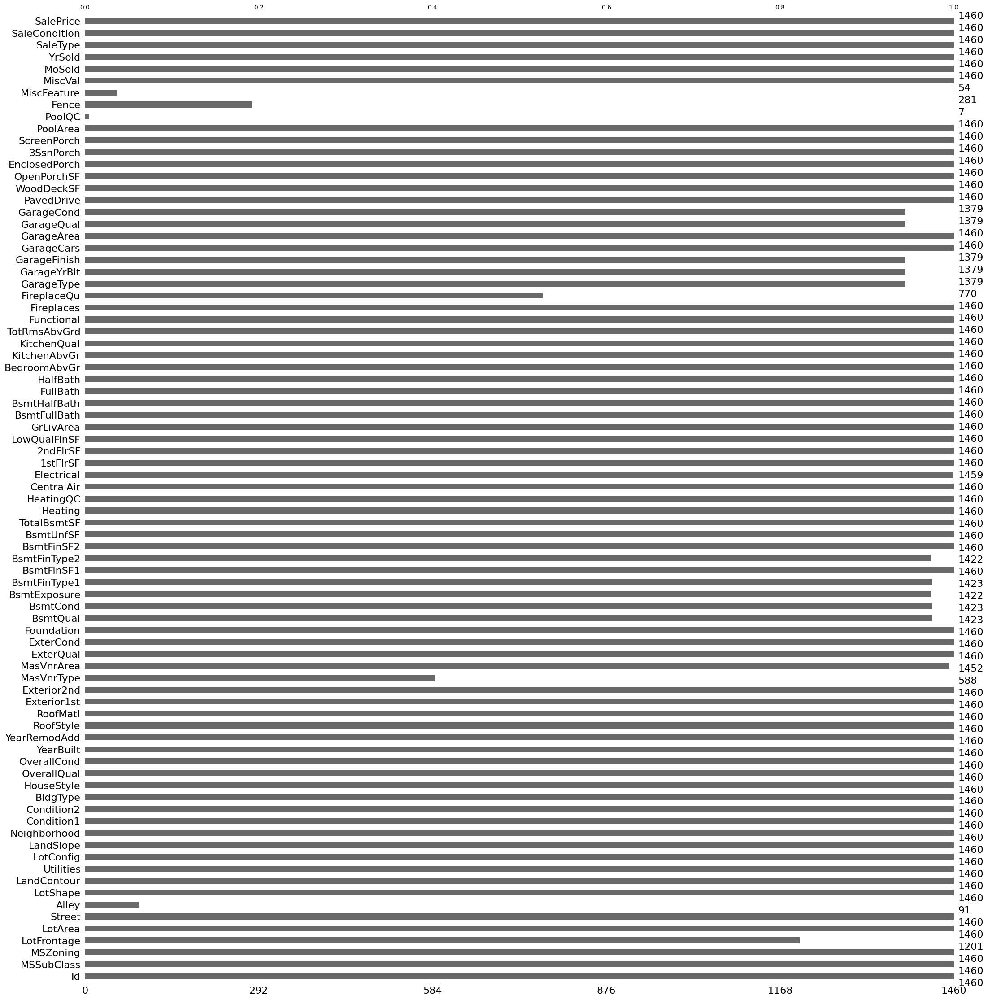

In [ ]:
import missingno as msno
%matplotlib inline
msno.bar(df1);

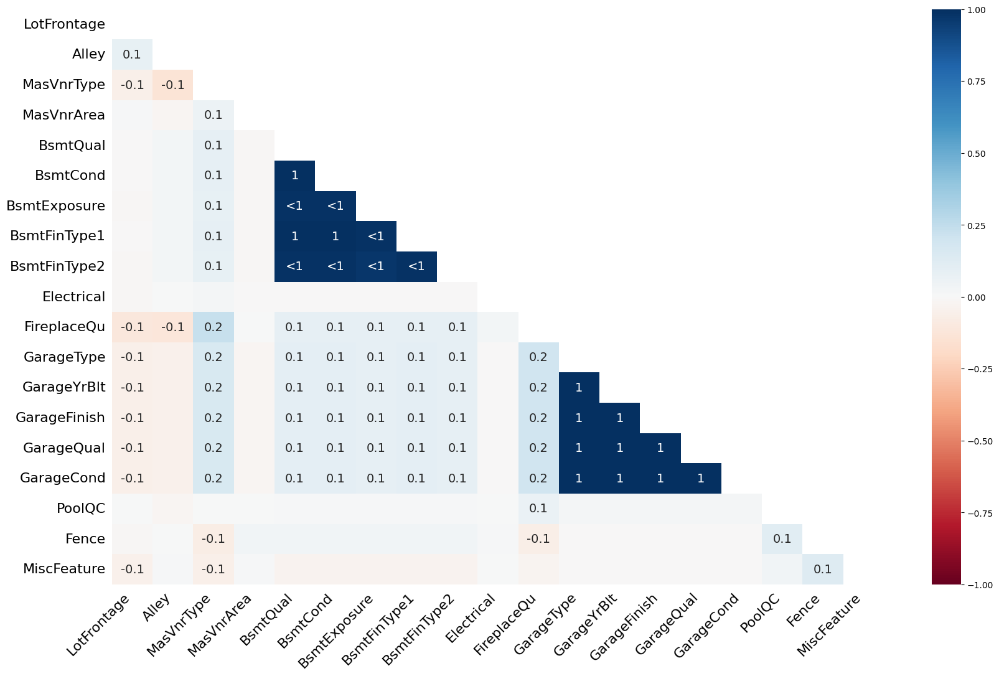

In [ ]:
msno.heatmap(df1);

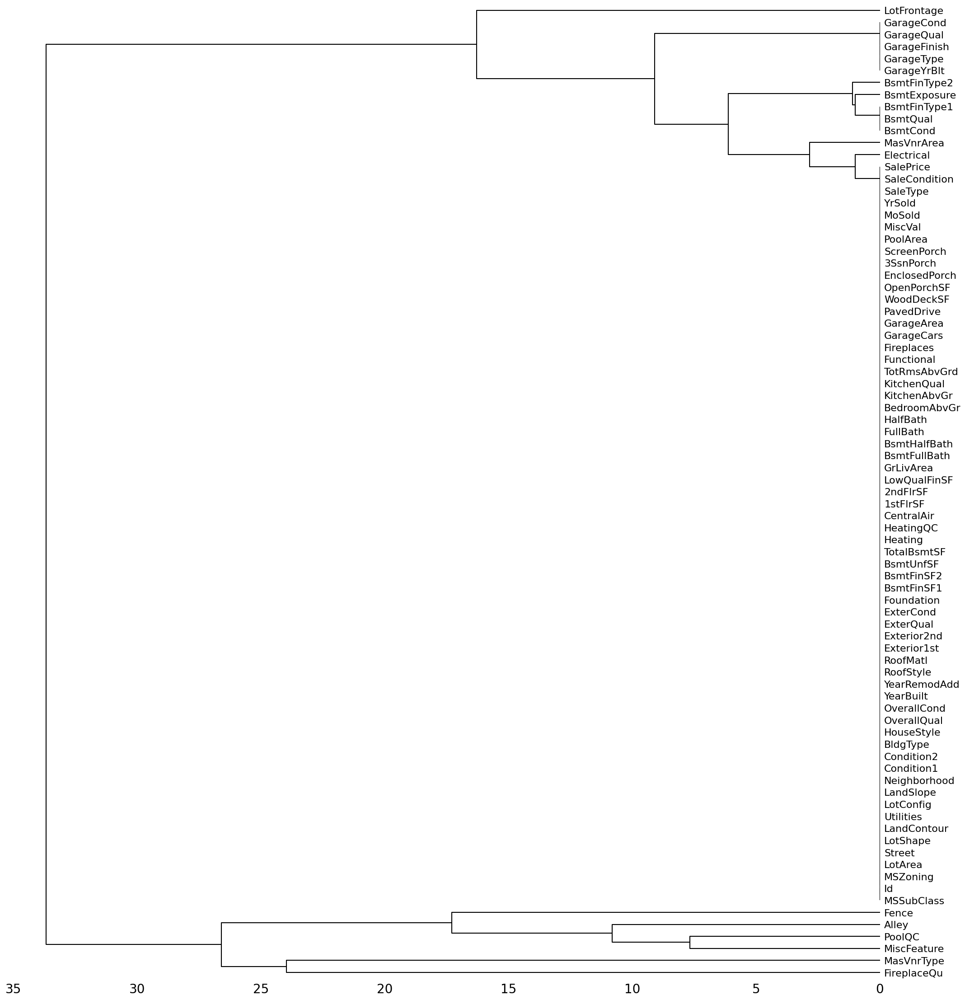

In [ ]:
msno.dendrogram(df1);

### Sweetviz

In [ ]:
!pip install sweetviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 23.5 MB/s eta 0:00:00


In [ ]:
import sweetviz as sv
analyze_report = sv.analyze(df2)
analyze_report.show_html('analyze.html', open_browser=False)

                                             |          | [  0%]   00:00 -> (? left)

Report analyze.html was generated.



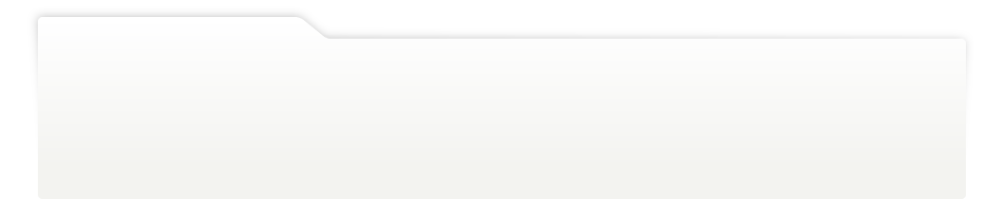
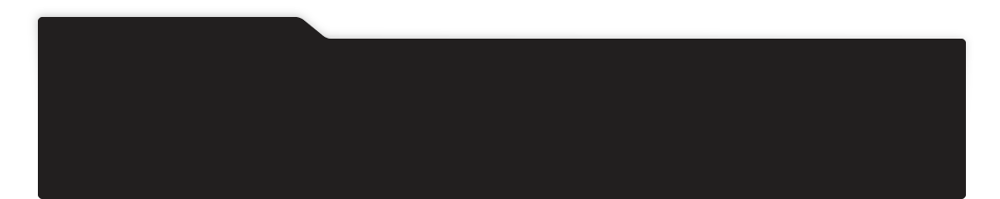
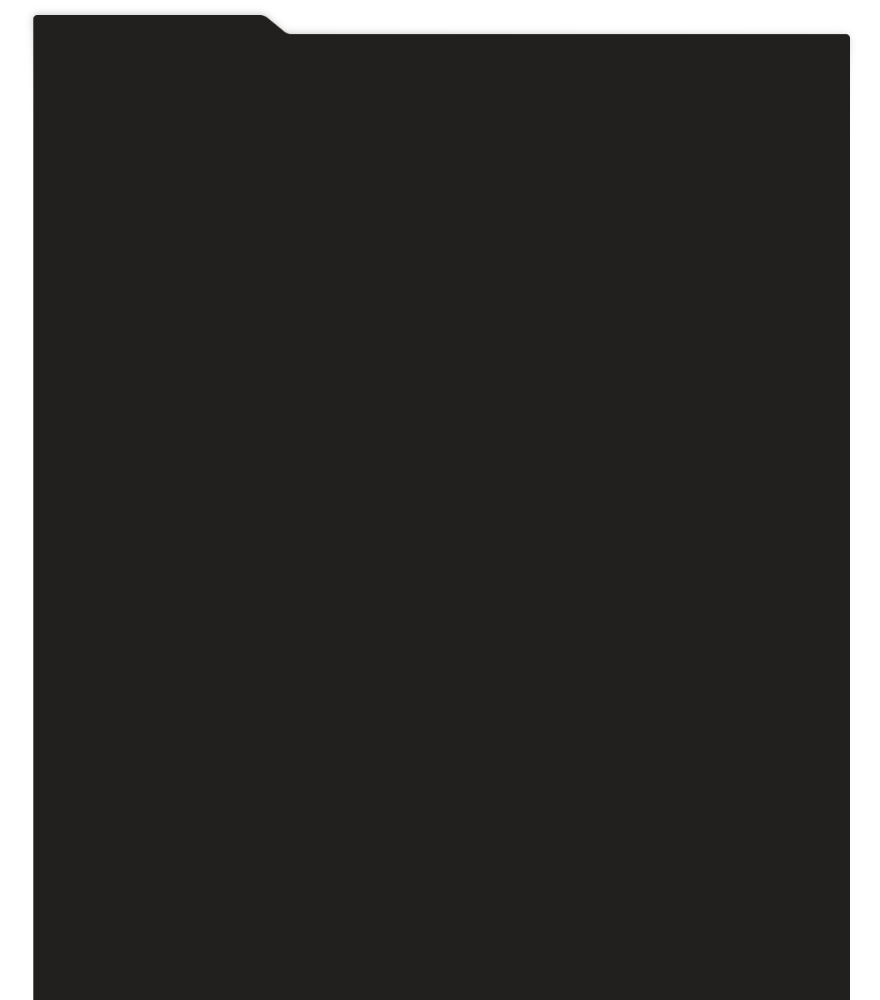
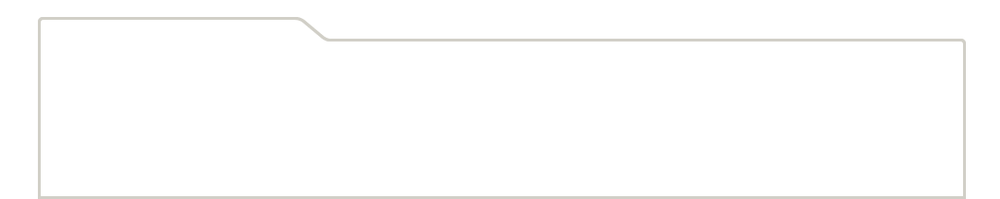
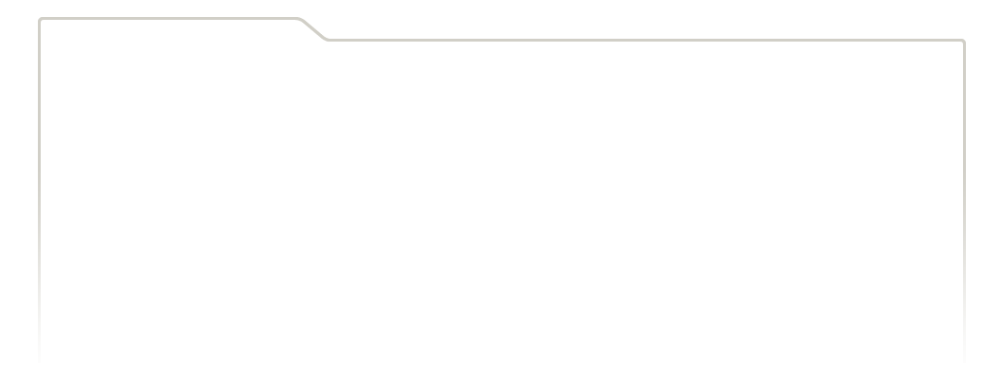
...
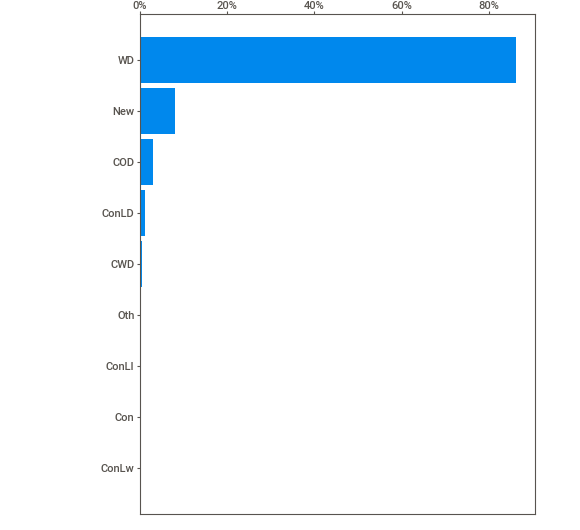
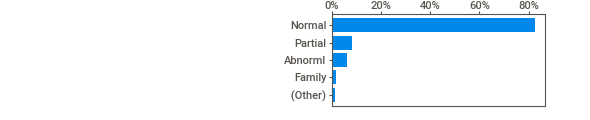
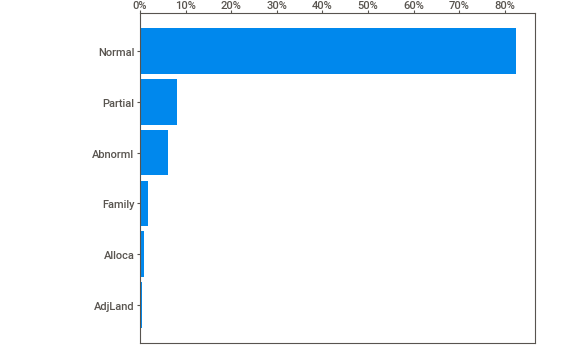
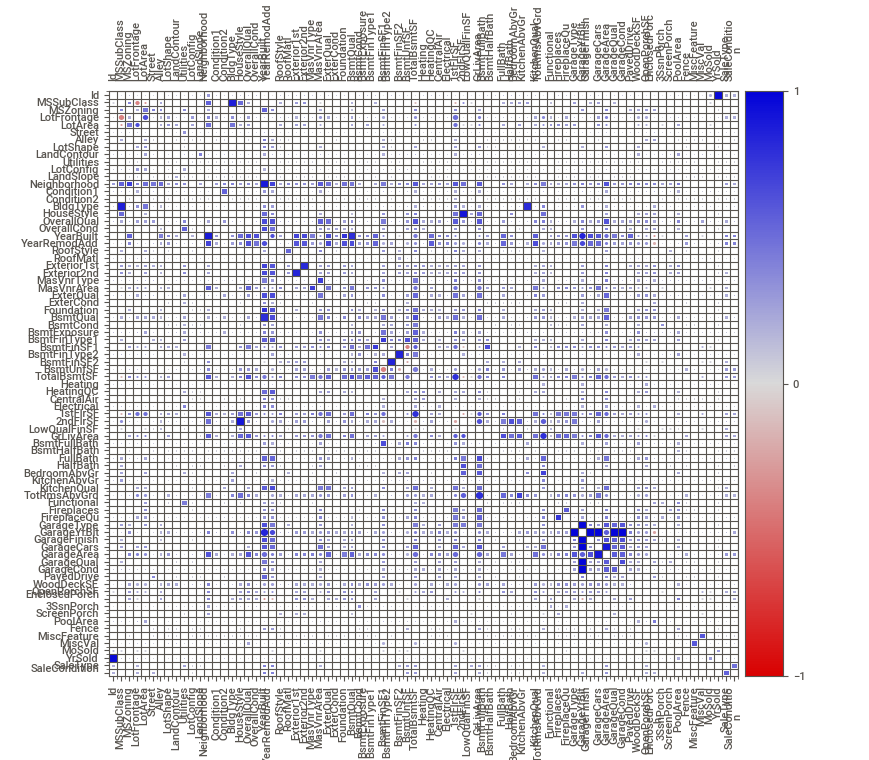
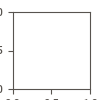

In [ ]:
import IPython
IPython.display.HTML('analyze.html')

### DataPrep

In [ ]:
 !pip install bokeh cohere openai tiktoken dataprep

  Using cached cohere-4.44-py3-none-any.whl (51 kB)
  Using cached openai-1.9.0-py3-none-any.whl (223 kB)
  Using cached tiktoken-0.5.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (2.0 MB)
  Using cached dataprep-0.4.5-py3-none-any.whl (9.9 MB)
  Using cached fastavro-1.9.3-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (3.1 MB)
  Using cached importlib_metadata-6.11.0-py3-none-any.whl (23 kB)
  Using cached httpx-0.26.0-py3-none-any.whl (75 kB)
  Using cached bokeh-2.4.3-py3-none-any.whl (18.5 MB)
  Using cached Flask_Cors-3.0.10-py2.py3-none-any.whl (14 kB)
  Using cached Jinja2-3.0.3-py3-none-any.whl (133 kB)
  Using cached jsonpath_ng-1.6.1-py3-none-any.whl (29 kB)
  Using cached Metaphone-0.6.tar.gz (14 kB)
  Preparing metadata (setup.py) ... done
  Using cached python_crfsuite-0.9.8-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (1.0 MB)
  Using cached python_stdnum-1.19-py2.py3-none-any.whl (1.0 MB)
  Using cached rapidfuzz-2.15.2-cp310-cp3

In [ ]:
from dataprep.eda import create_report
create_report(df1).show()

ModuleNotFoundError: No module named 'dataprep'


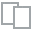
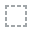
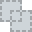
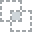
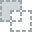
...
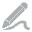
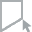
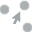
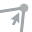
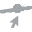

In [ ]:
from dataprep.eda import plot
plot(df1, "GrLivArea")

## Reducción de la dimensionalidad
### Análisis de componentes principales (PCA)

El Análisis de Componentes Principales (PCA - Principal Component Analysis) es una técnica estadística de reducción de dimensionalidad que se utiliza en el análisis de datos y en la ciencia de datos. Su objetivo principal es simplificar la complejidad de los espacios de datos multidimensionales mientras conserva la mayor cantidad posible de información valiosa.

#### Conceptos Clave del PCA:

1. **Reducción de Dimensionalidad**: PCA transforma un conjunto de variables posiblemente correlacionadas en un conjunto más pequeño de variables no correlacionadas llamadas componentes principales.
2. **Componentes Principales**: Son direcciones en el espacio de datos que maximizan la varianza (información) del conjunto de datos original. El primer componente principal captura la mayor varianza, el segundo componente principal (ortogonal al primero) captura la segunda mayor varianza, y así sucesivamente.
3. **Conservación de Información**: A pesar de que PCA reduce la cantidad de variables, intenta conservar tanto como sea posible la información (varianza) contenida en los datos originales.

4. **Visualización de Datos**: Al reducir los datos a menos dimensiones (usualmente dos o tres), se facilita la visualización y el análisis de patrones complejos en los datos.

#### Aplicaciones en Machine Learning
PCA es útil en la preparación de datos para modelos de aprendizaje automático, particularmente cuando se trabaja con conjuntos de datos de alta dimensionalidad. Ayuda a acelerar los tiempos de entrenamiento y a reducir problemas como la maldición de la dimensionalidad.



#### Funcionamiento del PCA
1. **Estandarización de Datos**: Generalmente, los datos se estandarizan para tener una media de cero y una varianza de uno antes de aplicar PCA.
2. **Matriz de Covarianza**: Se calcula para entender cómo las variables del conjunto de datos varían entre sí.
3. **Descomposición en Valores Propios**: La matriz de covarianza se descompone en valores propios y vectores propios. Estos vectores propios se convierten en los componentes principales.
4. **Selección de Componentes**: Se eligen los componentes principales más significativos basándose en la cantidad de varianza que cada uno captura.


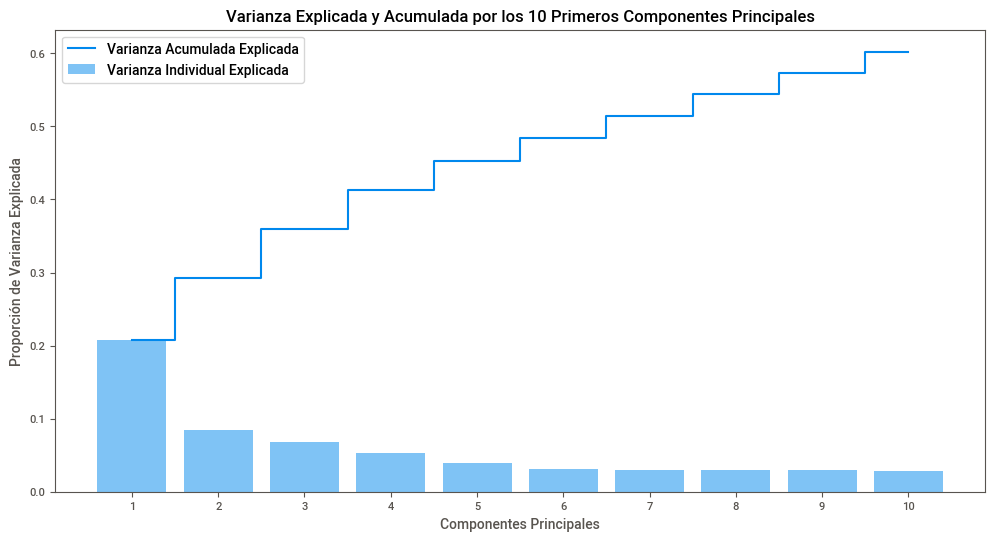

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Aplicar PCA para reducción de dimensionalidad
# Selección de características numéricas
numeric_features = df1.select_dtypes(include=['int64', 'float64'])
# Imputar valores NaN con la media de cada columna
numeric_features = numeric_features.fillna(numeric_features.median())

# Estandarización de las características
scaler = StandardScaler()
scaled_features = scaler.fit_transform(numeric_features)

# Aplicar PCA con los 10 primeros componentes
pca = PCA(n_components=10)
principal_components = pca.fit_transform(scaled_features)

# Varianza explicada por cada componente
explained_variances_cumulative = np.cumsum(explained_variances)

# Creación de un gráfico de la varianza explicada acumulada
plt.figure(figsize=(12, 6))
plt.bar(range(1, 11), explained_variances, alpha=0.5, align='center', label='Varianza Individual Explicada')
plt.step(range(1, 11), explained_variances_cumulative, where='mid', label='Varianza Acumulada Explicada')
plt.xlabel('Componentes Principales')
plt.ylabel('Proporción de Varianza Explicada')
plt.title('Varianza Explicada y Acumulada por los 10 Primeros Componentes Principales')
plt.xticks(range(1, 11))
plt.legend()
plt.show()